In [1]:
from fastcore.basics import Path, AttrDict

config = AttrDict(
    challenge_data_raw_dir = Path('../../data/1_dataset_raw/'),
    challenge_data_clean_dir = Path('../../data/2_dataset_clean/'),
    challenge_data_processed_dir = Path('../../data/3_dataset_processed/'),
    challenge_data_features_dir = Path('../../data/4_dataset_features/'),
    df_merged_small = Path('../../data/2_dataset_clean/df_merged_small.csv'),
    df_merged_medium = Path('../../data/2_dataset_clean/df_merged_medium.csv'),
    df_merged_large = Path('../../data/2_dataset_clean/df_merged_large.csv'),
    df_merged_full = Path('../../data/2_dataset_clean/df_merged_full.csv'),
    valid_ratio = 0.1,
    lag_steps = 5,
    tolerance= 6, # Default evaluation tolerance
)

# read df_merged_small
import pandas as pd
df_merged = pd.read_csv(config.df_merged_small)

df_merged

,Timestamp,Eccentricity,Semimajor Axis (m),Inclination (deg),RAAN (deg),Argument of Periapsis (deg),True Anomaly (deg),Latitude (deg),Longitude (deg),Altitude (m),X (m),Y (m),Z (m),Vx (m/s),Vy (m/s),Vz (m/s),ObjectID,TimeIndex,EW,NS
0,2022-09-01 00:00:00.000000Z,0.000202,4.216537e+07,0.139822,94.427336,52.733092,277.810980,-0.014460,85.119506,3.578607e+07,1.783837e+07,3.820485e+07,-50599.110117,-2786.228658,1300.258746,6.534142,1,0,SS-HK,SS-HK
1,2022-09-01 02:00:00.000000Z,0.000214,4.216458e+07,0.140008,94.407240,59.443909,301.205730,-0.007812,85.122842,3.578177e+07,-3.716169e+06,4.199580e+07,1168.075080,-3062.958599,-271.603808,7.513546,1,1,NaN,NaN
2,2022-09-01 04:00:00.000000Z,0.000231,4.216450e+07,0.140139,94.420500,64.355257,326.372111,0.001030,85.131695,3.577825e+07,-2.426888e+07,3.446997e+07,52684.232409,-2514.294041,-1770.701547,6.465207,1,2,NaN,NaN
3,2022-09-01 06:00:00.000000Z,0.000255,4.216524e+07,0.140147,94.419710,67.664873,353.158326,0.009633,85.144601,3.577642e+07,-3.828008e+07,1.765316e+07,90028.394917,-1287.802531,-2792.783114,3.667072,1,3,NaN,NaN
4,2022-09-01 08:00:00.000000Z,0.000277,4.216620e+07,0.140112,94.348243,70.366450,20.624466,0.015595,85.158717,3.577713e+07,-4.197225e+07,-3.922585e+06,103071.600288,285.868898,-3062.068198,-0.129326,1,4,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1086007,2023-02-28 14:00:00.000000Z,0.000259,4.216620e+07,0.330556,92.904571,150.339320,33.610261,-0.009389,-90.982913,3.577896e+07,5.031081e+06,-4.185581e+07,-16752.345303,3053.272821,366.567297,-17.699969,1448,2167,NaN,NaN
1086008,2023-02-28 16:00:00.000000Z,0.000249,4.216614e+07,0.330985,92.929672,151.886117,62.128571,-0.109903,-90.974987,3.578309e+07,2.534016e+07,-3.369610e+07,-136245.673746,2457.922327,1847.619633,-14.725976,1448,2168,NaN,NaN
1086009,2023-02-28 18:00:00.000000Z,0.000234,4.216581e+07,0.331218,92.974317,150.683588,93.369797,-0.180996,-90.973763,3.578825e+07,3.882169e+07,-1.645698e+07,-219185.765690,1200.595755,2830.444839,-7.780206,1448,2169,NaN,NaN
1086010,2023-02-28 20:00:00.000000Z,0.000219,4.216547e+07,0.331255,92.997529,147.083681,127.022519,-0.203458,-90.979706,3.579289e+07,4.184662e+07,5.215088e+06,-243184.348427,-379.638221,3050.676138,1.269573,1448,2170,NaN,NaN


In [2]:
list_object_id = list(df_merged['ObjectID'].unique())

In [3]:
def get_df_merged_query(df_merged, list_object_id, position):
    # Retrieve the ObjectID from the list based on the given position
    object_id = list_object_id[position]
    print("Object id is : {}".format(object_id))
    
    # Query df_merged where ObjectID matches the retrieved object_id
    # Note: @object_id inside the query string is used to reference the variable object_id
    return df_merged.query('ObjectID == @object_id')

df_merged_query = get_df_merged_query(df_merged, list_object_id, position = 10)


Object id is : 1007


In [4]:
df_merged_query

,Timestamp,Eccentricity,Semimajor Axis (m),Inclination (deg),RAAN (deg),Argument of Periapsis (deg),True Anomaly (deg),Latitude (deg),Longitude (deg),Altitude (m),X (m),Y (m),Z (m),Vx (m/s),Vy (m/s),Vz (m/s),ObjectID,TimeIndex,EW,NS
21720,2022-09-01 00:00:00.000000Z,0.000044,4.216591e+07,0.099456,93.404127,137.183849,6.550110,-0.010314,-102.713810,3.578595e+07,-2.287888e+07,-3.541702e+07,43294.547247,2582.701530,-1668.411037,-4.303288,1007,0,SS-NK,SS-NK
21721,2022-09-01 02:00:00.000000Z,0.005561,4.193110e+07,0.099702,93.346766,323.737894,210.067200,0.002934,-102.782174,3.575442e+07,-2.093515e+06,-4.208051e+07,7911.627645,3065.035336,-143.886806,-5.309864,1007,1,NaN,NaN
21722,2022-09-01 04:00:00.000000Z,0.005583,4.193089e+07,0.099854,93.357012,323.569488,240.325230,0.015317,-102.764441,3.566767e+07,1.925278e+07,-3.737886e+07,-29681.165053,2726.588662,1421.216331,-4.888728,1007,2,NaN,NaN
21723,2022-09-01 06:00:00.000000Z,0.005601,4.193163e+07,0.099875,93.362842,323.331248,270.808699,0.023551,-102.595515,3.554887e+07,3.536192e+07,-2.252564e+07,-59231.795022,1642.052901,2609.925745,-3.124289,1007,3,NaN,NaN
21724,2022-09-01 08:00:00.000000Z,0.005617,4.193249e+07,0.099847,93.312069,323.212225,301.405561,0.025382,-102.250581,3.543066e+07,4.178144e+07,-1.510262e+06,-72537.085915,96.928370,3090.730985,-0.479808,1007,4,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23887,2023-02-28 14:00:00.000000Z,0.000328,4.216577e+07,0.341604,92.671271,111.987096,205.116409,-0.148635,41.937928,3.580013e+07,2.723796e+07,3.220358e+07,-171169.853163,-2347.034839,1984.645948,13.426784,1007,2167,NaN,NaN
23888,2023-02-28 16:00:00.000000Z,0.000330,4.216616e+07,0.342110,92.627959,109.113412,238.099101,-0.051354,41.921383,3.579537e+07,7.438797e+06,4.151223e+07,-55735.380545,-3025.950658,541.385852,17.900767,1007,2168,NaN,NaN
23889,2023-02-28 18:00:00.000000Z,0.000340,4.216620e+07,0.342746,92.631867,108.448660,268.834344,0.060098,41.913447,3.578835e+07,-1.436268e+07,3.964493e+07,74938.597024,-2890.297279,-1048.248503,17.559826,1007,2169,NaN,NaN
23890,2023-02-28 20:00:00.000000Z,0.000351,4.216587e+07,0.343179,92.675767,110.170919,297.153019,0.155699,41.916051,3.578098e+07,-3.229506e+07,2.709955e+07,185648.623737,-1975.870093,-2356.260202,12.480792,1007,2170,NaN,NaN


In [ ]:
df_merged_query.to_csv("df_merged_query.csv")

In [ ]:
df_merged_query

# Plot other features

In [5]:
import pandas as pd
import plotly.graph_objects as go


def plot_orbital_parameter_with_events(df, parameter_name):
    # Ensure 'Timestamp' is in datetime format
    if not pd.api.types.is_datetime64_any_dtype(df['Timestamp']):
        df['Timestamp'] = pd.to_datetime(df['Timestamp'])

    # Extract the unique ObjectID (assuming all rows have the same ObjectID)
    object_id = df['ObjectID'].iloc[0]
    
    # Create the title with ObjectID and the parameter being plotted
    title = f'{parameter_name} Evolution for Object ID: {object_id} with NS and EW Events'

    # Create the base figure
    fig = go.Figure()

    # Add line for the specified orbital parameter
    fig.add_trace(go.Scatter(
        x=df['Timestamp'],
        y=df[parameter_name],
        mode='lines+markers',
        name=parameter_name,
        line=dict(color='blue'),
        marker=dict(size=4)  # Default marker size for the line plot
    ))
    
    # Add markers for NS events, ignoring NaN values, with increased size and a distinctive color
    for event in df['NS'].dropna().unique():
        df_event = df[df['NS'] == event]
        fig.add_trace(go.Scatter(
            x=df_event['Timestamp'],
            y=df_event[parameter_name],
            mode='markers',
            name=f'NS: {event}',
            marker=dict(symbol='circle', size=10, color='yellow')  # Larger, yellow markers for NS events
        ))
    
    # Add markers for EW events, ignoring NaN values, with increased size and a distinctive color
    for event in df['EW'].dropna().unique():
        df_event = df[df['EW'] == event]
        fig.add_trace(go.Scatter(
            x=df_event['Timestamp'],
            y=df_event[parameter_name],
            mode='markers',
            name=f'EW: {event}',
            marker=dict(symbol='x', size=10, color='magenta')  # Larger, magenta markers for EW events
        ))
    
    # Update plot layout
    fig.update_layout(
        title=title,
        xaxis_title='Timestamp',
        yaxis_title=parameter_name,
        legend_title='Event Type',
        legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01)  # Adjust legend position
    )

    fig.show()

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\188513481.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


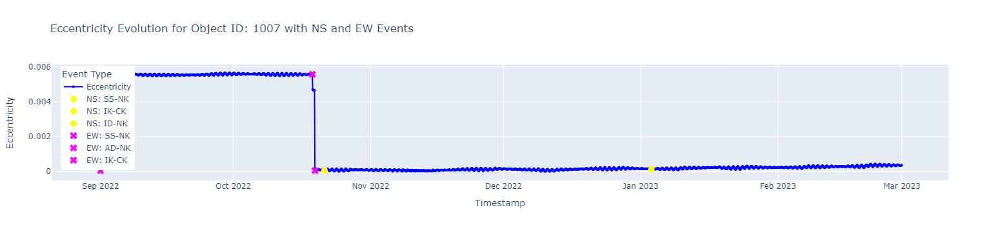

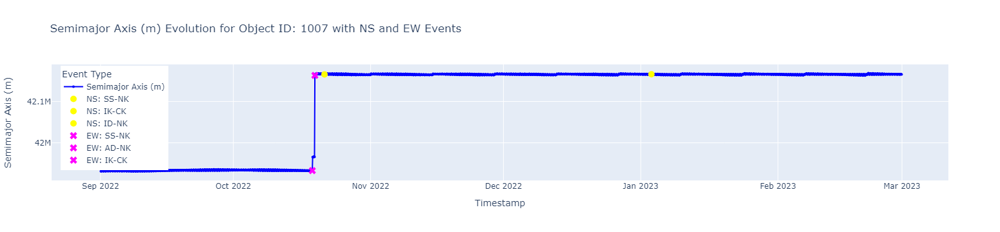

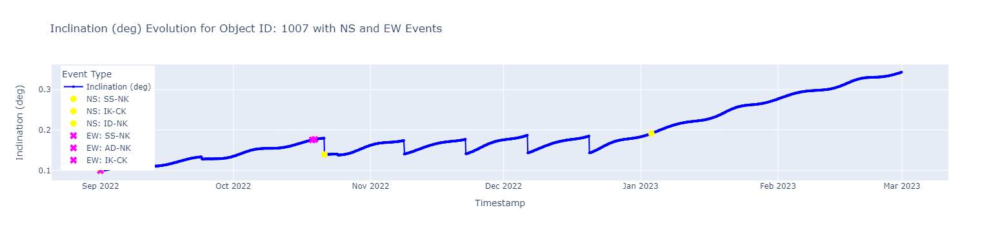

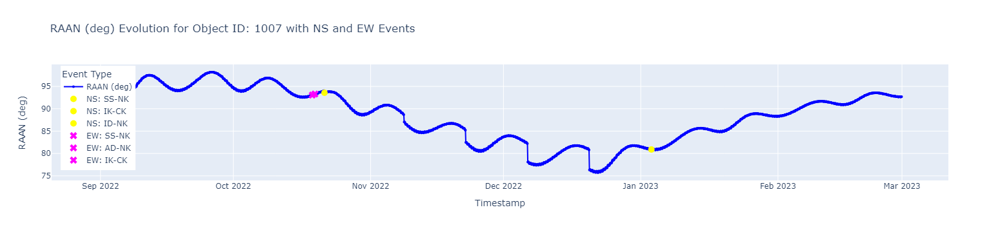

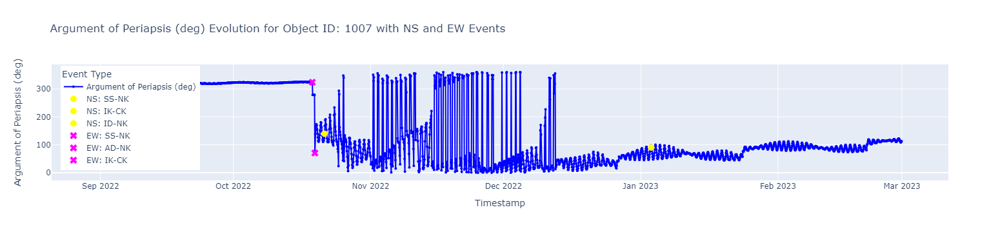

...

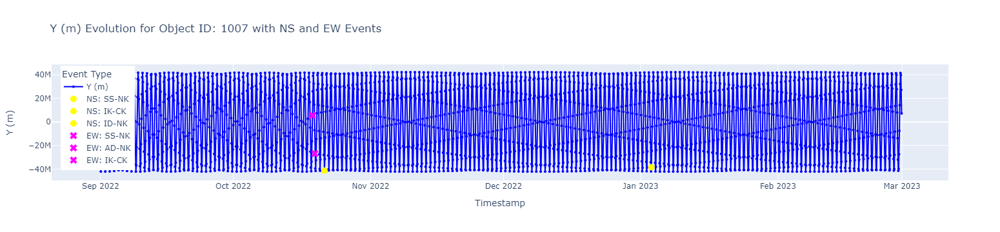

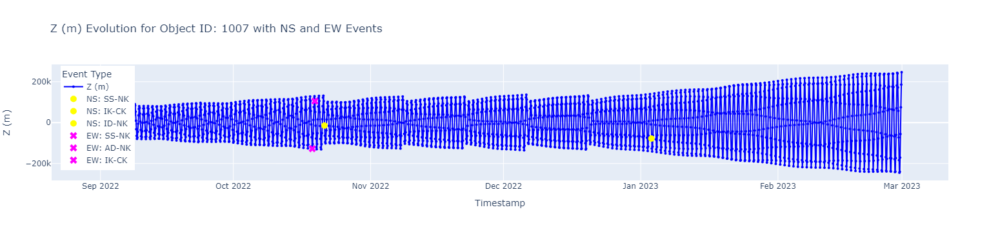

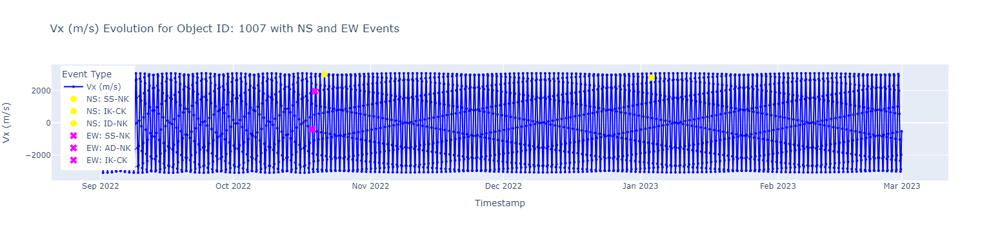

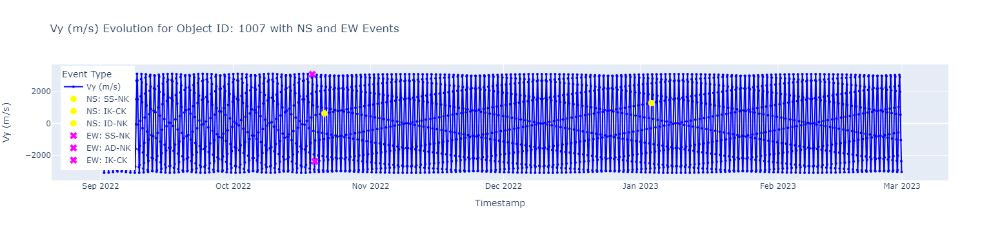

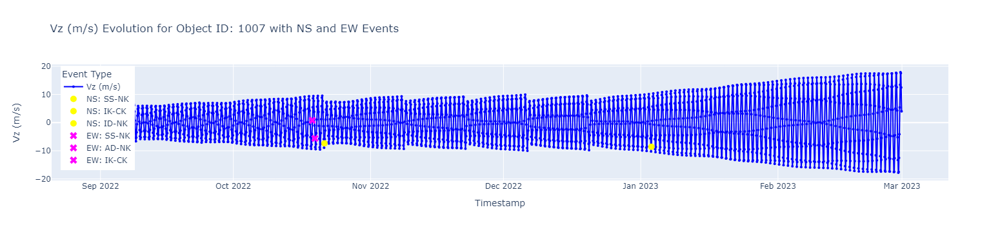

In [6]:


plot_orbital_parameter_with_events(df_merged_query, 'Eccentricity')
plot_orbital_parameter_with_events(df_merged_query, 'Semimajor Axis (m)')
plot_orbital_parameter_with_events(df_merged_query, 'Inclination (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'RAAN (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'Argument of Periapsis (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'True Anomaly (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'Latitude (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'Longitude (deg)')
plot_orbital_parameter_with_events(df_merged_query, 'Altitude (m)')
plot_orbital_parameter_with_events(df_merged_query, 'X (m)')
plot_orbital_parameter_with_events(df_merged_query, 'Y (m)')
plot_orbital_parameter_with_events(df_merged_query, 'Z (m)')
plot_orbital_parameter_with_events(df_merged_query, 'Vx (m/s)')
plot_orbital_parameter_with_events(df_merged_query, 'Vy (m/s)')
plot_orbital_parameter_with_events(df_merged_query, 'Vz (m/s)')


#

# Plot with isolation of feature

## General function to plot features

In [7]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

def plot_data_with_feature(df, feature_name_to_observe):
    # Ensure 'Timestamp' is in datetime format
    if not pd.api.types.is_datetime64_any_dtype(df['Timestamp']):
        df['Timestamp'] = pd.to_datetime(df['Timestamp'])
        
    # Find all columns that contain "Eccentricity" in the column name
    feature_columns = [col for col in df.columns if "feature" in col]
    print("feature_columns", feature_columns)

    # Extract the unique ObjectID (assuming all rows have the same ObjectID)
    object_id = df['ObjectID'].iloc[0]
    
    # Create the base figure
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=df['Timestamp'],
        y=df[feature_name_to_observe],
        mode='lines+markers',
        name=feature_name_to_observe,
        line=dict(color='blue'),
        marker=dict(size=4)  # Default marker size for the line plot
    ))

    for parameter_name in feature_columns:
        # Create the title with ObjectID and the parameter being plotted
        title = f'{parameter_name} Evolution for Object ID: {object_id} with NS and EW Events'

        # Add line for the current eccentricity parameter
        fig.add_trace(go.Scatter(
            x=df['Timestamp'],
            y=df[parameter_name],
            mode='lines+markers',
            name=parameter_name,
            line=dict(color='red'),
            marker=dict(size=4)  # Default marker size for the line plot
        ))

    # Add markers for NS events, ignoring NaN values, with increased size and a distinctive color
    for event in df['NS'].dropna().unique():
            df_event = df[df['NS'] == event]
            fig.add_trace(go.Scatter(
                x=df_event['Timestamp'],
                y=df_event[feature_name_to_observe],
                mode='markers',
                name=f'NS: {event}',
                marker=dict(symbol='circle', size=10, color='yellow')  # Larger, yellow markers for NS events
            ))
        
    # Add markers for EW events, ignoring NaN values, with increased size and a distinctive color
    for event in df['EW'].dropna().unique():
        df_event = df[df['EW'] == event]
        fig.add_trace(go.Scatter(
            x=df_event['Timestamp'],
            y=df_event[feature_name_to_observe],
            mode='markers',
            name=f'EW: {event}',
            marker=dict(symbol='x', size=10, color='magenta')  # Larger, magenta markers for EW events
            ))
    
        # Update plot layout for the last plotted parameter (consider adjusting if needed)
        fig.update_layout(
            title=title,
            xaxis_title='Timestamp',
            yaxis_title=parameter_name,
            legend_title='Event Type',
            legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01)  # Adjust legend position
        )

    fig.show()


### Eccentricity

In [8]:
df_merged.columns.tolist()

['Timestamp',
 'Eccentricity',
 'Semimajor Axis (m)',
 'Inclination (deg)',
 'RAAN (deg)',
 'Argument of Periapsis (deg)',
 'True Anomaly (deg)',
 'Latitude (deg)',
 'Longitude (deg)',
 'Altitude (m)',
 'X (m)',
 'Y (m)',
 'Z (m)',
 'Vx (m/s)',
 'Vy (m/s)',
 'Vz (m/s)',
 'ObjectID',
 'TimeIndex',
 'EW',
 'NS']

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


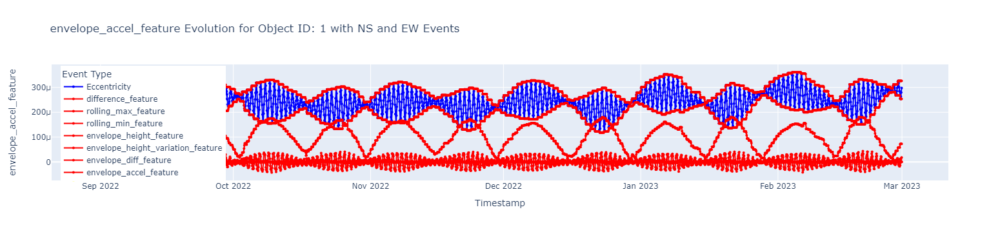

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


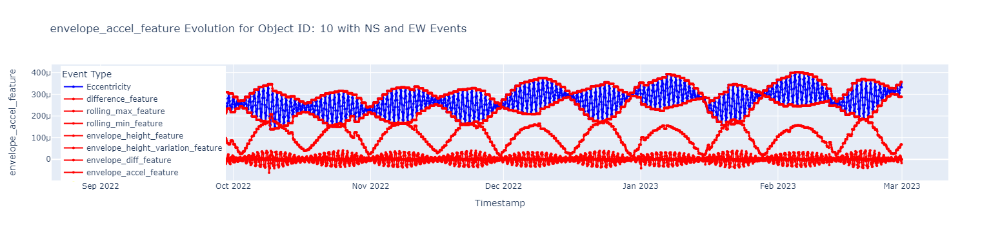

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


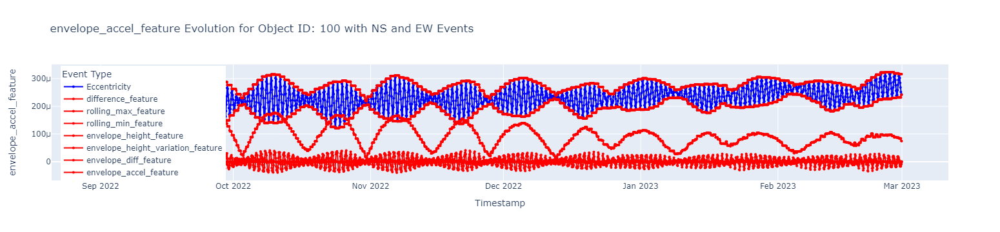

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


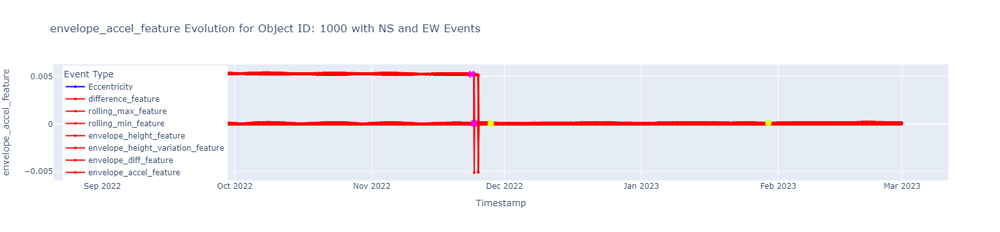

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


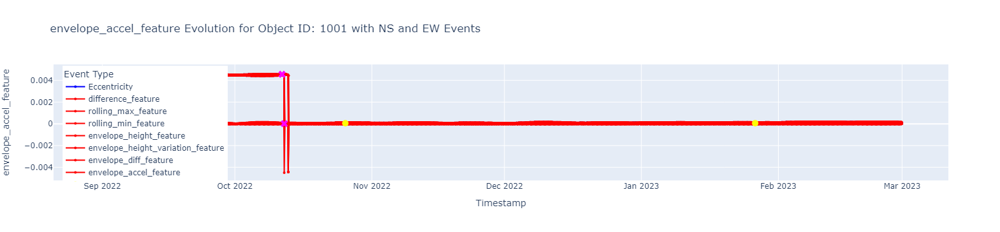

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


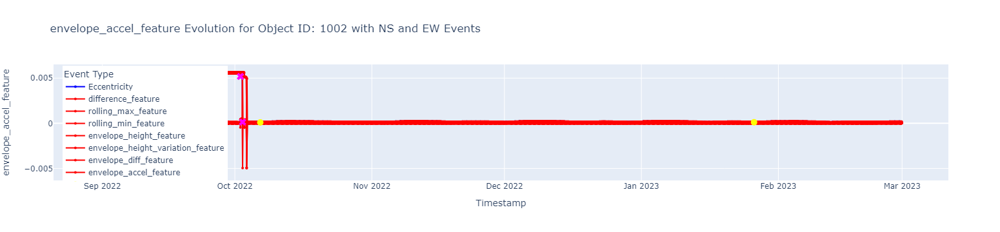

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


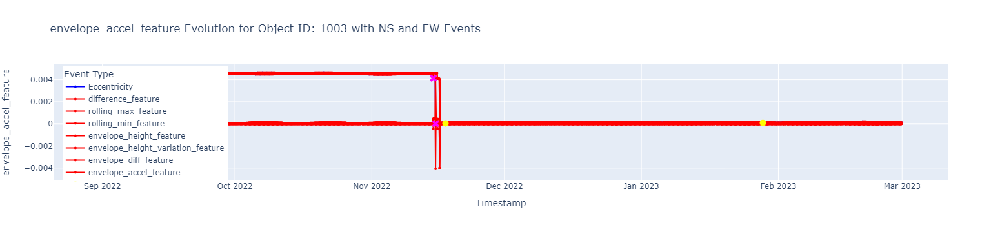

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


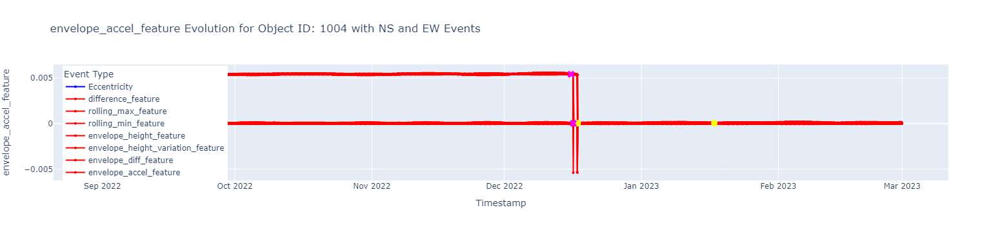

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


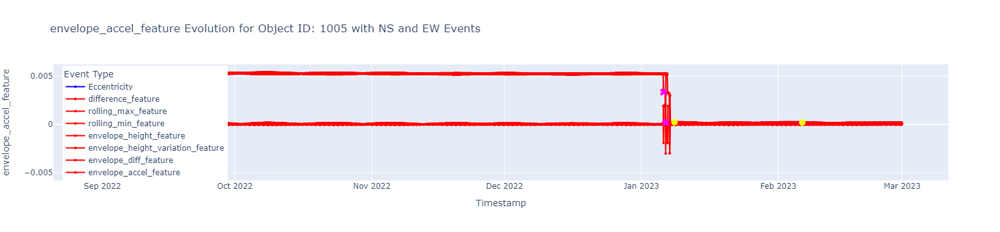

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\3984185030.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['difference_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


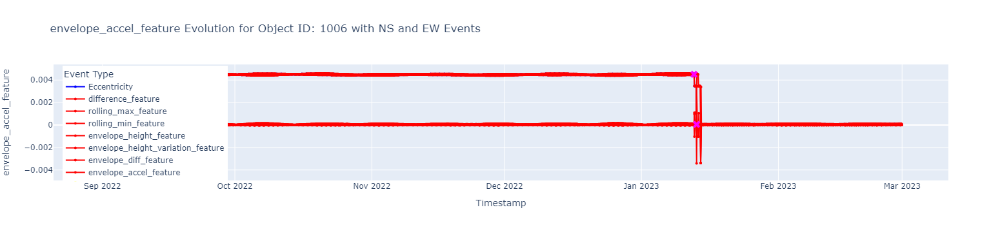

In [9]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

data_name = "Eccentricity"

for object_id in list_of_20_object_id:
    df_merged_query = df_merged.query("ObjectID == @object_id")
    
   # Create the new features
    df_merged_query['difference_feature'] = df_merged_query['Eccentricity'].diff()
    df_merged_query['rolling_max_feature'] = df_merged_query['Eccentricity'].rolling(12).max()
    df_merged_query['rolling_min_feature'] = df_merged_query['Eccentricity'].rolling(12).min()
    df_merged_query['envelope_height_feature'] = df_merged_query['rolling_max_feature'] - df_merged_query['rolling_min_feature']
    df_merged_query['envelope_height_variation_feature'] = df_merged_query['envelope_height_feature'].diff()
    df_merged_query['envelope_diff_feature'] = df_merged_query['rolling_max_feature'].diff()
    df_merged_query['envelope_accel_feature'] = df_merged_query['envelope_diff_feature'].diff()
    
    
    
    plot_data_with_feature(df = df_merged_query, feature_name_to_observe=data_name)

In [ ]:
df_merged_query = df_merged.query("ObjectID == 1760")
df_merged_query.to_csv("df_merged_query.csv")

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

# Convert the "Timestamp" column to datetime and set it as the index
df_merged_query['Timestamp'] = pd.to_datetime(df_merged_query['Timestamp'])
df_merged_query.set_index('Timestamp', inplace=True)

# Ensure the dataset has a consistent frequency
df_merged_query = df_merged_query.asfreq(pd.infer_freq(df_merged_query.index))

# Perform seasonal decomposition to identify the trend, seasonal, and residual components
decomposition = seasonal_decompose(df_merged_query['Eccentricity'], model='additive', period=12)  # Adjust the period according to your data's seasonality

# Plot the decomposed components
decomposition_plot = decomposition.plot()
plt.show()


In [ ]:
# Remove the seasonality from the "Eccentricity" data
eccentricity_deseasonalized = df_merged_query['Eccentricity'] - decomposition.seasonal - decomposition.trend

eccentricity_deseasonalized.plot()

# Vx (m/s)

In [ ]:
df_merged_query.columns.tolist()

In [ ]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

data_name = "Vx (m/s)"

for object_id in list_of_20_object_id:
    df_merged_query = df_merged.query("ObjectID == @object_id")
    
   # Create the new features
    # df_merged_query['vx_diff_feature'] = df_merged_query[data_name].diff()
    # df_merged_query['vx_accel_feature'] = df_merged_query['vx_diff_feature'].diff()
    # df_merged_query['daily_mean_feature'] = df_merged_query[data_name].rolling(12).mean()
    # df_merged_query['weekly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7).mean()
    # df_merged_query['monthly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).mean()
    
    # df_merged_query['daily_std_feature'] = df_merged_query[data_name].rolling(12).std()
    # df_merged_query['weekly_std_feature'] = df_merged_query[data_name].rolling(12 * 7).std()
    # df_merged_query['monthly_std_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).std()
    
    df_merged_query['rolling_max_feature'] = df_merged_query[data_name].rolling(12).max()
    df_merged_query['rolling_min_feature'] = df_merged_query[data_name].rolling(12).min()
    df_merged_query['envelope_height_feature'] = df_merged_query['rolling_max_feature'] - df_merged_query['rolling_min_feature']
    df_merged_query['envelope_height_variation_feature'] = df_merged_query['envelope_height_feature'].diff()
    df_merged_query['envelope_max_daily_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12).std()
    df_merged_query['envelope_max_weekly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7).std()
    df_merged_query['envelope_max_monthly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7*30).std()
    # df_merged_query['envelope_diff_feature'] = df_merged_query['rolling_max_feature'].diff()
    # df_merged_query['envelope_accel_feature'] = df_merged_query['envelope_diff_feature'].diff()
    
    
    
    plot_data_with_feature(df = df_merged_query, feature_name_to_observe=data_name)

## Periapsis

In [ ]:
df_merged_query.columns.tolist()

In [ ]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

data_name = "Argument of Periapsis (deg)"

for object_id in list_of_20_object_id:
    df_merged_query = df_merged.query("ObjectID == @object_id")
    
   # Create the new features
    # df_merged_query['vx_diff_feature'] = df_merged_query[data_name].diff()
    # df_merged_query['vx_accel_feature'] = df_merged_query['vx_diff_feature'].diff()
    # df_merged_query['daily_mean_feature'] = df_merged_query[data_name].rolling(12).mean()
    # df_merged_query['weekly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7).mean()
    # df_merged_query['monthly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).mean()
    
    df_merged_query['daily_std_feature'] = df_merged_query[data_name].rolling(12).std()
    df_merged_query['weekly_std_feature'] = df_merged_query[data_name].rolling(12 * 7).std()
    
    df_merged_query['daily_std_diff_feature'] = df_merged_query['daily_std_feature'].diff()
    
    # smoothed version
    df_merged_query['smoothed_daily_std_feature'] = df_merged_query['daily_std_feature'].rolling(12).mean()
    df_merged_query['daily_std_diff_smoothed_feature'] = df_merged_query['smoothed_daily_std_feature'].diff()
    
    # df_merged_query['monthly_std_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).std()
    
    # df_merged_query['rolling_max_feature'] = df_merged_query[data_name].rolling(12).max()
    # df_merged_query['rolling_min_feature'] = df_merged_query[data_name].rolling(12).min()
    # df_merged_query['envelope_height_feature'] = df_merged_query['rolling_max_feature'] - df_merged_query['rolling_min_feature']
    # df_merged_query['envelope_height_variation_feature'] = df_merged_query['envelope_height_feature'].diff()
    # df_merged_query['envelope_max_daily_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12).std()
    # df_merged_query['envelope_max_weekly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7).std()
    # df_merged_query['envelope_max_monthly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7*30).std()
    # df_merged_query['envelope_diff_feature'] = df_merged_query['rolling_max_feature'].diff()
    # df_merged_query['envelope_accel_feature'] = df_merged_query['envelope_diff_feature'].diff()
    
    
    
    plot_data_with_feature(df = df_merged_query, feature_name_to_observe=data_name)

# Latitude

# Latitude in degrees

In [ ]:
df_merged_query.columns.tolist()

# Altitude

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_merged_query['daily_std_feature'] = df_merged_query[data_name].rolling(12).std()
/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Timestamp'] = pd.to_datetime(df['Timestamp'])


feature_columns ['daily_std_feature']


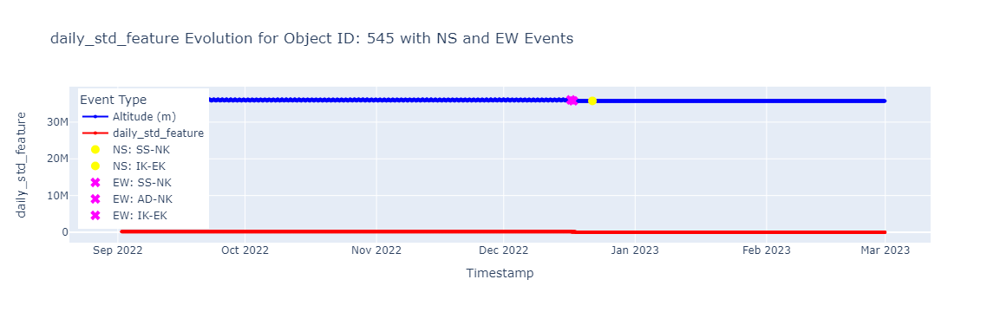

feature_columns ['daily_std_feature']


/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



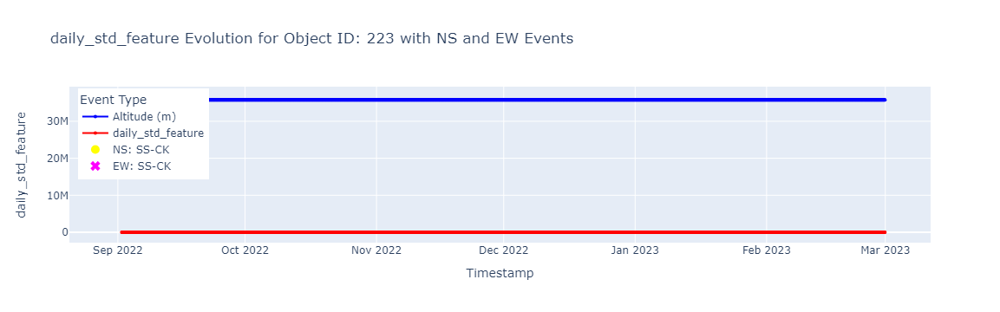

feature_columns ['daily_std_feature']


/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



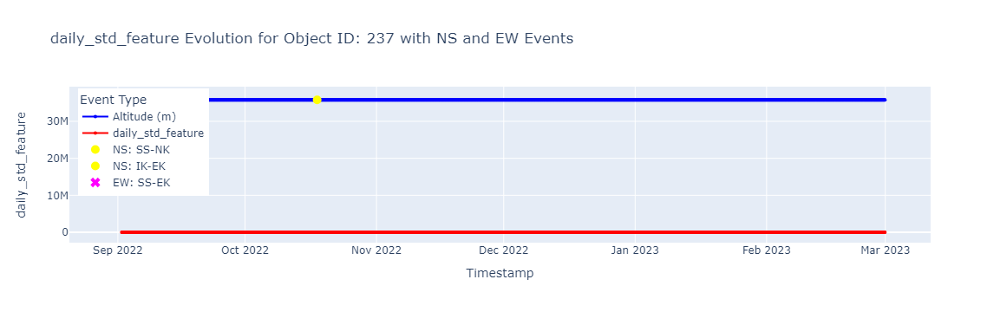

feature_columns ['daily_std_feature']


/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



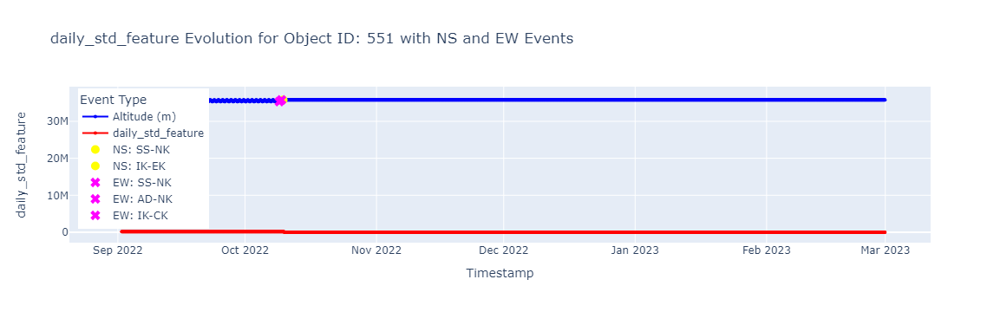

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



feature_columns ['daily_std_feature']


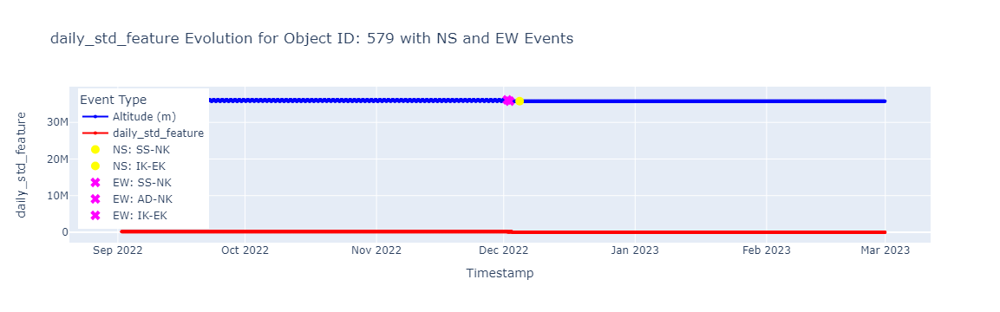

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



feature_columns ['daily_std_feature']


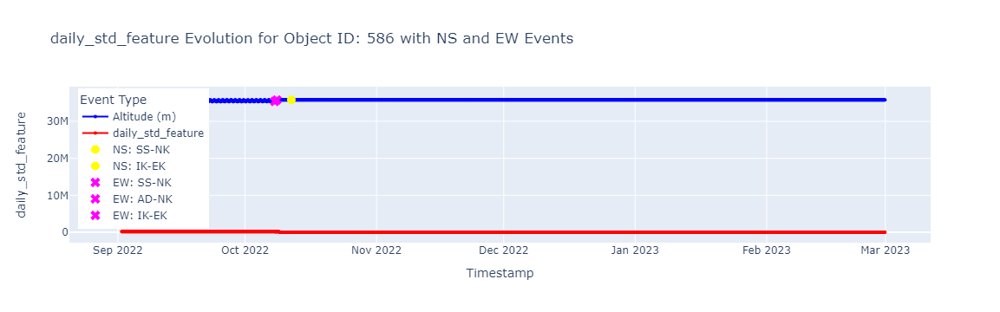

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



feature_columns ['daily_std_feature']


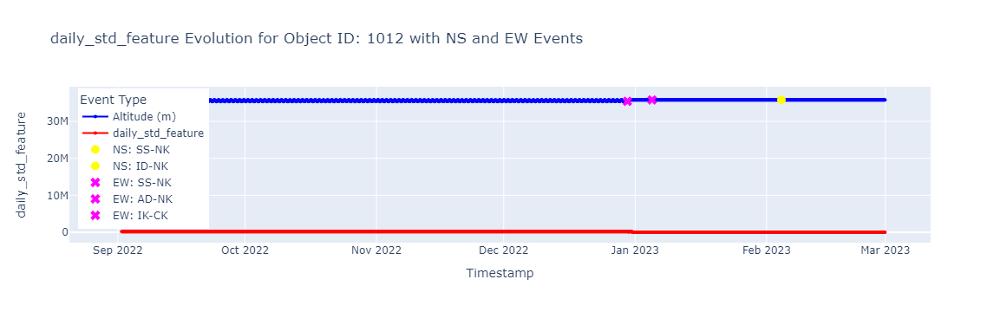

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



feature_columns ['daily_std_feature']


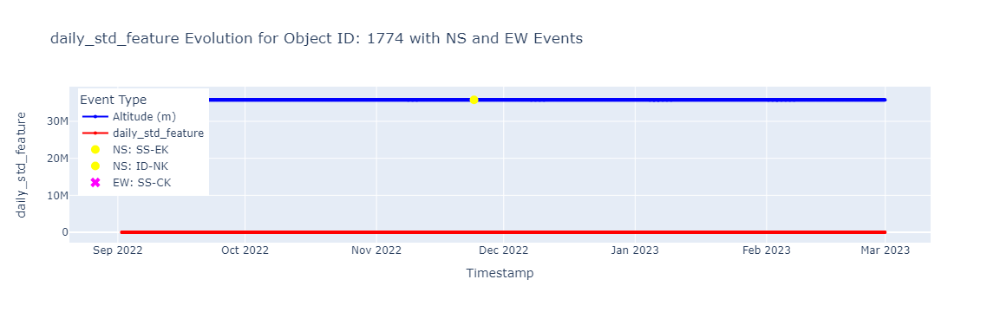

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



feature_columns ['daily_std_feature']


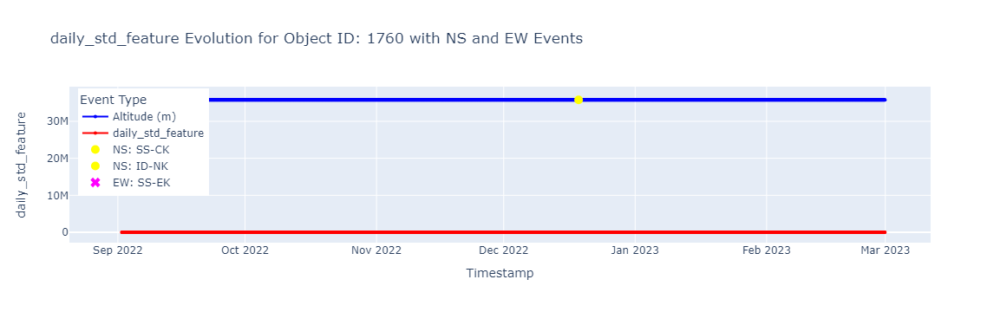

feature_columns ['daily_std_feature']


/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/2582148302.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/xf/y0x1jxvj7f1btzf3x9cjl9_80000gn/T/ipykernel_35668/4268678356.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



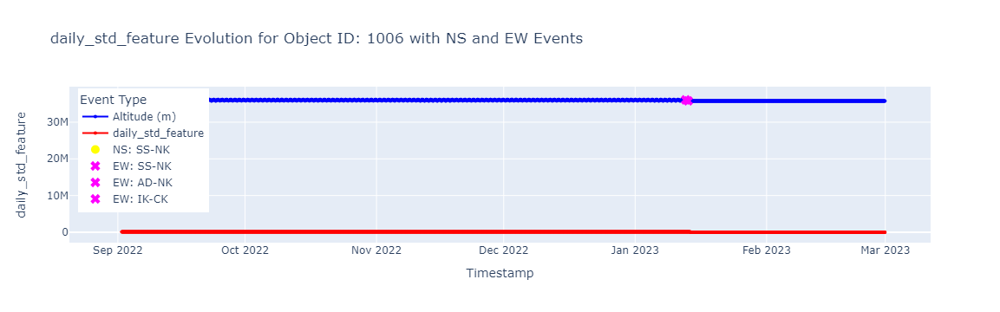

In [6]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

data_name = "Altitude (m)"

for object_id in list_of_20_object_id:
    df_merged_query = df_merged.query("ObjectID == @object_id")
    
   # Create the new features
    # df_merged_query['vx_diff_feature'] = df_merged_query[data_name].diff()
    # df_merged_query['vx_accel_feature'] = df_merged_query['vx_diff_feature'].diff()
    # df_merged_query['daily_mean_feature'] = df_merged_query[data_name].rolling(12).mean()
    # df_merged_query['weekly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7).mean()
    # df_merged_query['monthly_mean_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).mean()
    
    df_merged_query['daily_std_feature'] = df_merged_query[data_name].rolling(12).std()
    # df_merged_query['weekly_std_feature'] = df_merged_query[data_name].rolling(12 * 7).std()
    
    # df_merged_query['daily_std_diff_feature'] = df_merged_query['daily_std_feature'].diff()
    
    # # smoothed version
    # df_merged_query['smoothed_daily_std_feature'] = df_merged_query['daily_std_feature'].rolling(12).mean()
    # df_merged_query['daily_std_diff_smoothed_feature'] = df_merged_query['smoothed_daily_std_feature'].diff()
    
    # df_merged_query['monthly_std_feature'] = df_merged_query[data_name].rolling(12 * 7 * 30).std()
    
    # df_merged_query['rolling_max_feature'] = df_merged_query[data_name].rolling(12).max()
    # df_merged_query['rolling_min_feature'] = df_merged_query[data_name].rolling(12).min()
    # df_merged_query['envelope_height_feature'] = df_merged_query['rolling_max_feature'] - df_merged_query['rolling_min_feature']
    # df_merged_query['envelope_height_variation_feature'] = df_merged_query['envelope_height_feature'].diff()
    # df_merged_query['envelope_max_daily_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12).std()
    # df_merged_query['envelope_max_weekly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7).std()
    # df_merged_query['envelope_max_monthly_std_feature'] = df_merged_query['rolling_max_feature'].rolling(12*7*30).std()
    # df_merged_query['envelope_diff_feature'] = df_merged_query['rolling_max_feature'].diff()
    # df_merged_query['envelope_accel_feature'] = df_merged_query['envelope_diff_feature'].diff()
    
    
    
    plot_data_with_feature(df = df_merged_query, feature_name_to_observe=data_name)

# Latitude

In [ ]:

list_of_20_object_id = list(df_merged['ObjectID'].unique())[:10]
list_of_column_names = df_merged.columns.tolist()
import pandas as pd
import plotly.graph_objects as go

data_name = "Latitude (deg)"

for object_id in list_of_20_object_id:
    df_merged_query = df_merged.query("ObjectID == @object_id")
    
   # Create the new features
    df_merged_query['latitude_diff_feature'] = df_merged_query[data_name].diff()
    df_merged_query['rolling_max_feature'] = df_merged_query[data_name].rolling(12).max()
    df_merged_query['rolling_min_feature'] = df_merged_query[data_name].rolling(12).min()
    df_merged_query['envelope_height_feature'] = df_merged_query['rolling_max_feature'] - df_merged_query['rolling_min_feature']
    df_merged_query['envelope_height_variation_feature'] = df_merged_query['envelope_height_feature'].diff()
    df_merged_query['envelope_diff_feature'] = df_merged_query['rolling_max_feature'].diff()
    df_merged_query['envelope_accel_feature'] = df_merged_query['envelope_diff_feature'].diff()
    
    
    
    plot_data_with_feature(df = df_merged_query, feature_name_to_observe=data_name)

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['latitude_diff_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\isaac\AppData\Local\Temp\ipykernel_29136\2144481339.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

feature_columns ['latitude_diff_feature', 'rolling_max_feature', 'rolling_min_feature', 'envelope_height_feature', 'envelope_height_variation_feature', 'envelope_diff_feature', 'envelope_accel_feature']


# Vx (m/s)

In [ ]:
df_merged_query.columns.tolist()